<a href="https://colab.research.google.com/github/FatimaJahara/ComplexityT2I/blob/main/test_complexity_2_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install diffusers==0.18.0
!pip install transformers scipy ftfy
!pip install "ipywidgets>=7,<8"

In [ ]:
import torch
from diffusers import StableDiffusionPipeline
from PIL import Image

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
# model21 = "stabilityai/stable-diffusion-2-1"
model15 = "runwayml/stable-diffusion-v1-5"

# pipe21 = StableDiffusionPipeline.from_pretrained(model21)
pipe15 = StableDiffusionPipeline.from_pretrained(model15)

# pipe21 = pipe21.to("cuda")
pipe15 = pipe15.to("cuda")

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


In [ ]:
def image_grid(imgs, rows=2, cols=2):
    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

def get_inputs(prompt, batch_size=1):
  generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
  prompts = batch_size * [prompt]
  num_inference_steps = 20

  return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps}

In [ ]:
prompts = ["A cat",
           "A black cat",
           "A photo of a cat",
           "A black cat with green eyes",
           "A black cat with green eyes sitting",
           "A black cat with green eyes sitting on a red pillow",
           "A black cat with green eyes sitting on a red pillow near a window",
           "A black cat with green eyes sitting on a red pillow near a window, with sunlight filtering in",
           "A black cat with green eyes sitting on a red pillow near a window, with sunlight filtering in and casting shadows",
           "A black cat with green eyes sitting on a red mat near a window, with sunlight filtering in and casting shadows. A bowl of milk is placed nearby."]

image_set = []
for prompt in prompts:
    images = pipe15(**get_inputs(prompt, batch_size=5)).images
    image_set.append(images)
    image_grid(images, rows=1, cols=5)

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

In [ ]:
import numpy as np
from PIL import Image

def calculate_l2_norm(image1, image2):
    # Convert PIL Images to numpy arrays
    array1 = np.array(image1)
    array2 = np.array(image2)
    l2_norm = np.sqrt(np.sum(np.power((array1-array2),2)))
    return l2_norm

# Calculate the L2 norm for each pair of images
# l2_norm_12 = []
l2_norm = [[],[],[],[],[],[],[],[],[]]
for i in range(5):
    l2_norm[0].append(calculate_l2_norm(image_set[0][i], image_set[1][i]))
    l2_norm[1].append(calculate_l2_norm(image_set[0][i], image_set[2][i]))
    l2_norm[2].append(calculate_l2_norm(image_set[0][i], image_set[3][i]))
    l2_norm[3].append(calculate_l2_norm(image_set[0][i], image_set[4][i]))
    l2_norm[4].append(calculate_l2_norm(image_set[0][i], image_set[5][i]))
    l2_norm[5].append(calculate_l2_norm(image_set[0][i], image_set[6][i]))
    l2_norm[6].append(calculate_l2_norm(image_set[0][i], image_set[7][i]))
    l2_norm[7].append(calculate_l2_norm(image_set[0][i], image_set[8][i]))
    l2_norm[8].append(calculate_l2_norm(image_set[0][i], image_set[9][i]))

print(l2_norm)

[[121870.39009127689, 134659.66696453694, 114702.65068863927, 127717.1599003047, 140676.1939348659], [140845.96786205843, 126440.1789899081, 123726.49398168527, 145212.7045130694, 145197.57730072495], [140826.54565457464, 130284.6143602536, 119536.28723948222, 131746.52760509477, 147268.08752407972], [137984.89037209834, 132669.02757614528, 122934.92111275786, 133037.89543960773, 147310.83418744188], [123263.11556584963, 122871.74621124256, 122311.88650331578, 128241.6693473693, 135113.79178677505], [129982.83901731028, 113656.65235260098, 111386.92249092799, 135042.57327228328, 122736.5251504213], [131922.13053540335, 123064.87392834724, 123491.64035269756, 133859.03084588653, 126420.36137426598], [132438.54269811336, 122388.77297366782, 115584.45177444932, 138455.53664263483, 128097.93668908176], [132524.92411995563, 114823.60753346849, 127097.11554555438, 140647.95762825708, 119683.62728878164]]


In [ ]:
import numpy as np

def calculate_l2_norm(image1, image2):
    # Convert PIL Images to numpy arrays
    array1 = np.array(image1)
    array2 = np.array(image2)
    l2_norm = np.sqrt(np.sum(np.power((array1-array2),2)))
    return l2_norm

# Calculate the L2 norm for each pair of images
l2_norm = [[],[],[],[],[],[],[],[],[],[]]
for i in range(5):
    l2_norm[0].append(calculate_l2_norm(image_set[0][i], image_set[1][i]))
    l2_norm[1].append(calculate_l2_norm(image_set[0][i], image_set[2][i]))
    l2_norm[2].append(calculate_l2_norm(image_set[0][i], image_set[3][i]))
    l2_norm[3].append(calculate_l2_norm(image_set[0][i], image_set[4][i]))
    l2_norm[4].append(calculate_l2_norm(image_set[0][i], image_set[5][i]))
    l2_norm[5].append(calculate_l2_norm(image_set[0][i], image_set[6][i]))
    l2_norm[6].append(calculate_l2_norm(image_set[0][i], image_set[7][i]))
    l2_norm[7].append(calculate_l2_norm(image_set[0][i], image_set[8][i]))
    l2_norm[8].append(calculate_l2_norm(image_set[0][i], image_set[9][i]))

# Flatten the l2_norm list and calculate minimum and maximum
flat_l2_norm = [norm for sublist in l2_norm for norm in sublist]
min_value = np.min(flat_l2_norm)
max_value = np.max(flat_l2_norm)

# Normalize the L2 norms
l2_norm_normalized = [[(val - min_value) / (max_value - min_value) for val in sublist] for sublist in l2_norm]

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def l2_norm_group_bar(l2_norms_complexity):

    image_pairs = ["Pair 1", "Pair 2", "Pair 3", "Pair 4", "Pair 5"]  # And these with your actual image pair names
    complexities = ["1-2", "1-3", "1-4", "1-5", "1-6", "1-7", "1-8", "1-9", "1-10"]

# The number of complexities
    N = len(complexities)

# The x locations for the groups
    ind = np.arange(N)

# The width of the bars
    width = 0.1

# Create a figure and a set of subplots
    fig, ax = plt.subplots()

    for i in range(len(image_pairs)):
        ax.bar(ind + i*width, [l2[i] for l2 in l2_norms_complexity], width, label=image_pairs[i])

    # Add some text for labels, title and custom x-axis tick labels, etc.
    ax.set_xlabel('Complexity')
    # ax.set_ylabel('Normalized L2 Norm')
    # ax.set_title('Normalized L2 Norms by complexity and fixed-seed image pairs')
    ax.set_ylabel('L2 Norm')
    ax.set_title('L2 Norms by complexity and image pairs')
    ax.set_xticks(ind + width / 2)
    ax.set_xticklabels(complexities)
    # ax.legend()

    # Show the plot
    plt.show()

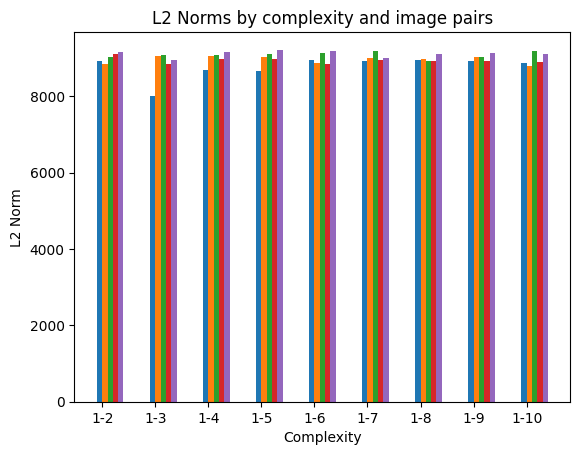

In [ ]:
l2_norm_group_bar(l2_norm[:9])

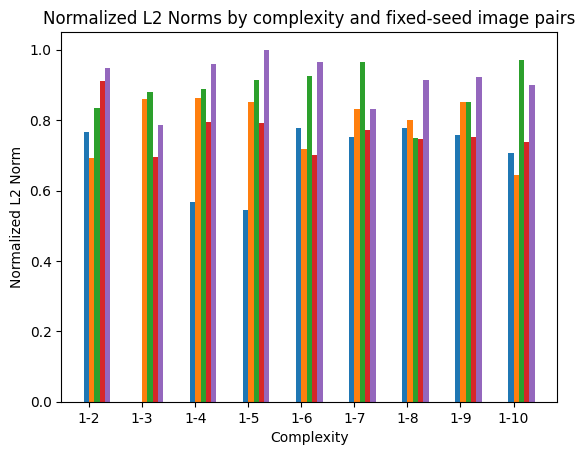

In [ ]:
l2_norm_group_bar(l2_norm_normalized[:9])

In [ ]:
# import matplotlib.pyplot as plt

# # List of list of images
# your_list_of_images = image_set

# # Create figure with sub-plots.
# fig, axes = plt.subplots(len(your_list_of_images), len(your_list_of_images[0]), figsize=(10, 20))

# # Iterate over the sub-plots and show images.
# for i, row in enumerate(axes):
#     for j, ax in enumerate(row):
#         ax.imshow(your_list_of_images[i][j])
#         ax.axis('off')  # to remove the axis of image sub-plots

# plt.show()


# import matplotlib.pyplot as plt

# # List of list of images
# your_list_of_images = image_set

# # Create figure with sub-plots.
# fig, axes = plt.subplots(len(your_list_of_images), len(your_list_of_images[0]), figsize=(20, 20))

# # Iterate over the sub-plots and show images.
# for i, row in enumerate(axes):
#     for j, ax in enumerate(row):
#         ax.imshow(your_list_of_images[i][j], aspect='auto')  # set aspect to 'auto'
#         ax.axis('off')  # to remove the axis of image sub-plots

# # Remove the spaces between subplots
# plt.subplots_adjust(wspace=0, hspace=0)

# plt.show()

In [ ]:
import numpy as np
# Calculate the L2 norm for each pair of images
l2_norm2 = [[],[],[],[],[],[],[],[],[],[]]
for i in range(5):
    l2_norm2[0].append(calculate_l2_norm(image_set[0][i], image_set[1][i]))
    l2_norm2[1].append(calculate_l2_norm(image_set[1][i], image_set[2][i]))
    l2_norm2[2].append(calculate_l2_norm(image_set[2][i], image_set[3][i]))
    l2_norm2[3].append(calculate_l2_norm(image_set[3][i], image_set[4][i]))
    l2_norm2[4].append(calculate_l2_norm(image_set[4][i], image_set[5][i]))
    l2_norm2[5].append(calculate_l2_norm(image_set[5][i], image_set[6][i]))
    l2_norm2[6].append(calculate_l2_norm(image_set[6][i], image_set[7][i]))
    l2_norm2[7].append(calculate_l2_norm(image_set[7][i], image_set[8][i]))
    l2_norm2[8].append(calculate_l2_norm(image_set[8][i], image_set[9][i]))

# Flatten the l2_norm list and calculate minimum and maximum
flat_l2_norm = [norm for sublist in l2_norm2 for norm in sublist]
min_value = np.min(flat_l2_norm)
max_value = np.max(flat_l2_norm)

# Normalize the L2 norms
l2_norm_normalized2 = [[(val - min_value) / (max_value - min_value) for val in sublist] for sublist in l2_norm2]

In [ ]:
def l2_norm_group_bar2(l2_norms_complexity):

    image_pairs = ["Pair 1", "Pair 2", "Pair 3", "Pair 4", "Pair 5"]  # And these with your actual image pair names
    complexities = ["1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9", "9-10"]

# The number of complexities
    N = len(complexities)

# The x locations for the groups
    ind = np.arange(N)

# The width of the bars
    width = 0.1

# Create a figure and a set of subplots
    fig, ax = plt.subplots()

    for i in range(len(image_pairs)):
        ax.bar(ind + i*width, [l2[i] for l2 in l2_norms_complexity], width, label=image_pairs[i])

    # Add some text for labels, title and custom x-axis tick labels, etc.
    ax.set_xlabel('Complexity')
    ax.set_ylabel('Normalized L2 Norm')
    ax.set_title('Normalized L2 Norms by complexity and fixed-seed image pairs')
    ax.set_xticks(ind + width / 2)
    ax.set_xticklabels(complexities)
    ax.legend()

    # Show the plot
    plt.show()

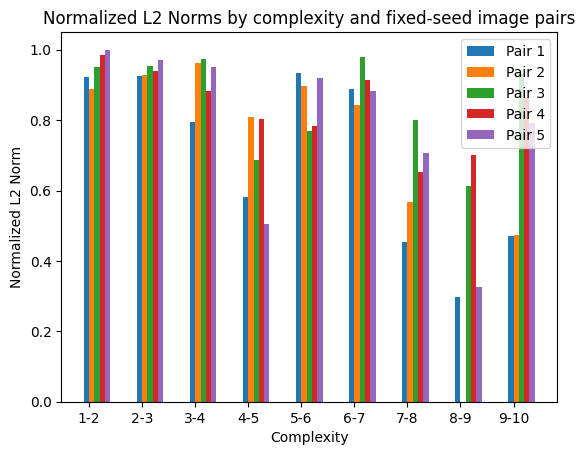

In [ ]:
l2_norm_group_bar2(l2_norm_normalized2[:9])

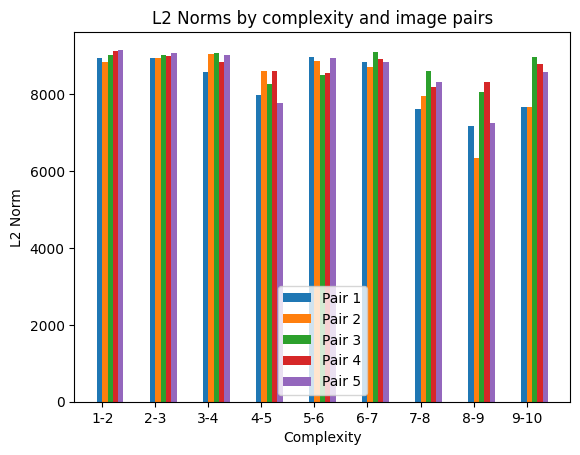

In [ ]:
l2_norm_group_bar2(l2_norm2[:9])

In [ ]:
import matplotlib.pyplot as plt

# List of list of images
your_list_of_images = image_set

# Create figure with sub-plots.
fig, axes = plt.subplots(len(your_list_of_images), len(your_list_of_images[0]), figsize=(20, 20))

# Iterate over the sub-plots and show images.
for i, row in enumerate(axes):
    for j, ax in enumerate(row):
        ax.imshow(your_list_of_images[i][j])
        ax.axis('off')  # to remove the axis of image sub-plots

# Remove the spaces between subplots
plt.subplots_adjust(wspace=0, hspace=0)

plt.show()

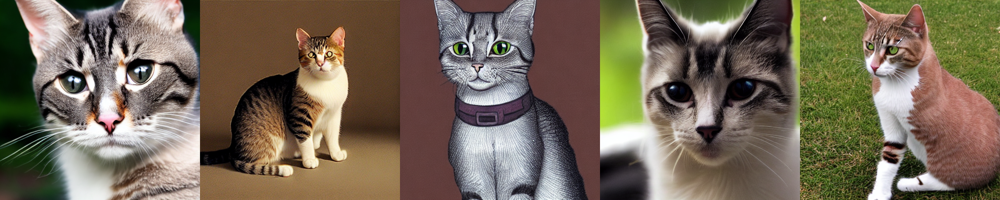

In [ ]:
image_grid(image_set[0], rows=1, cols=5)

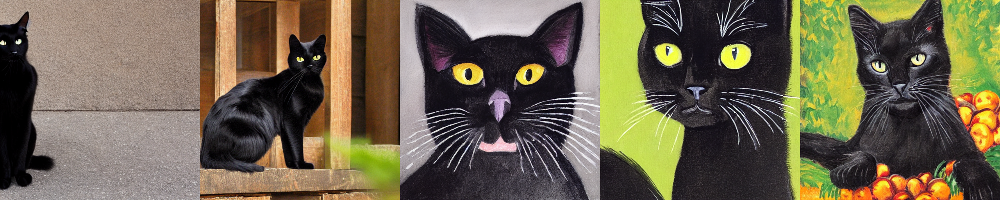

In [ ]:
image_grid(image_set[1], rows=1, cols=5)

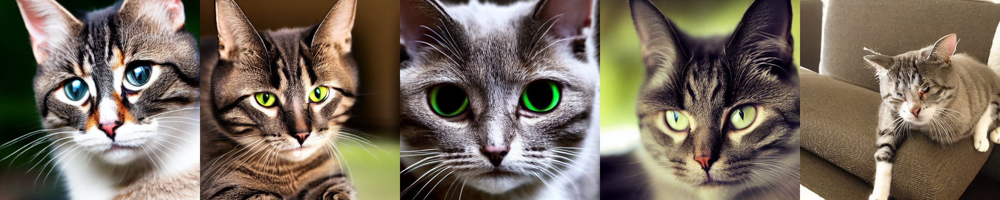

In [ ]:
image_grid(image_set[2], rows=1, cols=5)

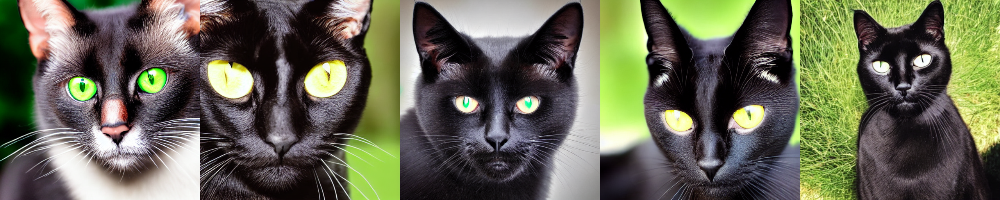

In [ ]:
image_grid(image_set[3], rows=1, cols=5)

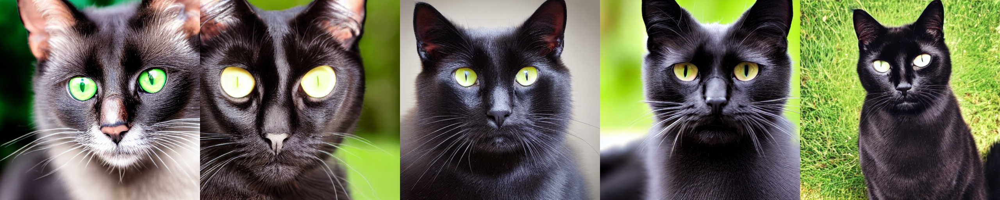

In [ ]:
image_grid(image_set[4], rows=1, cols=5)

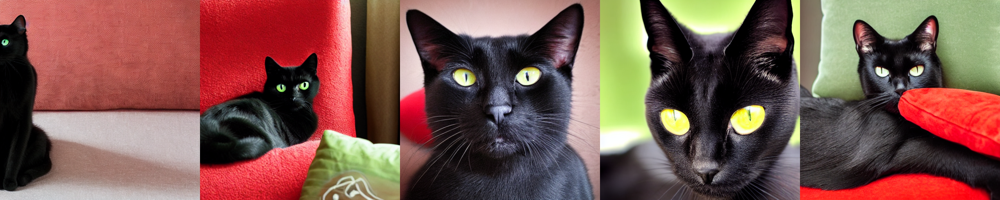

In [ ]:
image_grid(image_set[5], rows=1, cols=5)

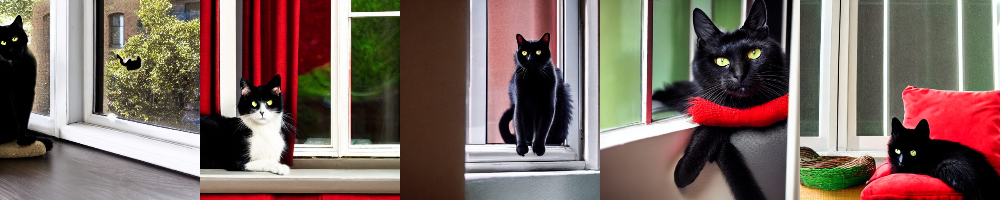

In [ ]:
image_grid(image_set[6], rows=1, cols=5)

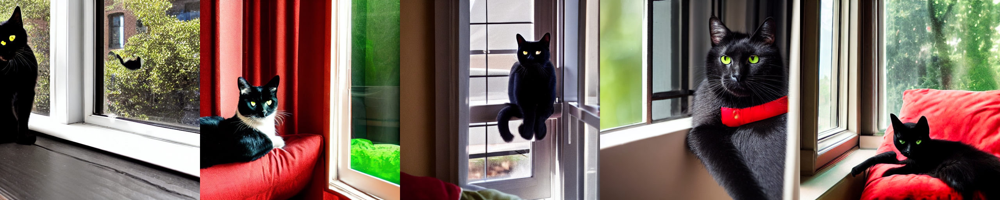

In [ ]:
image_grid(image_set[7], rows=1, cols=5)

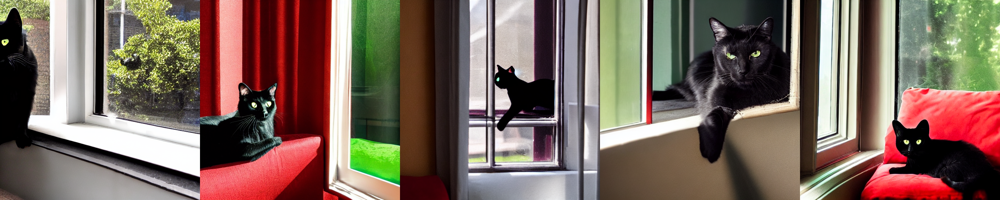

In [ ]:
image_grid(image_set[8], rows=1, cols=5)

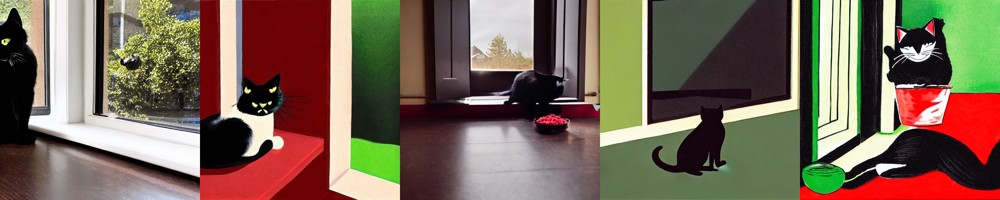

In [ ]:
image_grid(image_set[9], rows=1, cols=5)

IndexError: ignored